# Object Detection


This Colab demonstrates use of a TF-Hub module trained to perform object detection.

## Setup


In [22]:

try:
    import tensorflow_hub as hub
    import tensorflow as tf
    module_handle = "D:/pythonwork/Eating_health_management/faster_rcnn_openimages_v4_inception_resnet_v2_1"
    ResNet_V2_50 = 'https://tfhub.dev/google/imagenet/resnet_v2_50/classification/5'
    
    print("Loading {} Model...".format(module_handle.split("/")[-1]))
    detector = hub.load(module_handle).signatures['default']
    print("Load {} Model Successfully".format(module_handle.split("/")[-1]))

    print("Loading {} Model...".format(ResNet_V2_50.split("/")[-3]))
    model_ResNet = tf.keras.Sequential([
    hub.KerasLayer(ResNet_V2_50, trainable = False, input_shape = (250,250,3), name = 'Resnet_V2_50'),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(101, activation = 'softmax', name = 'Output_layer')
    ])
    model_ResNet.load_weights("./best_model/20220117-032102_Resnet_V2_50_best_weight.hdf5")
    print("Load {} Model Successfully".format(ResNet_V2_50.split("/")[-3]))
    
    
    
except:
    print("Load Model Failed")



Loading faster_rcnn_openimages_v4_inception_resnet_v2_1 Model...
INFO:tensorflow:Saver not created because there are no variables in the graph to restore
Load faster_rcnn_openimages_v4_inception_resnet_v2_1 Model Successfully
Loading resnet_v2_50 Model...
Load resnet_v2_50 Model Successfully


Tensorflow Version: 2.7.0
The following GPU devices are available: /device:GPU:0
Inference No.1 Food Image
Found 100 objects.
Inference time:  0.8749134540557861
Font not found, using default font.


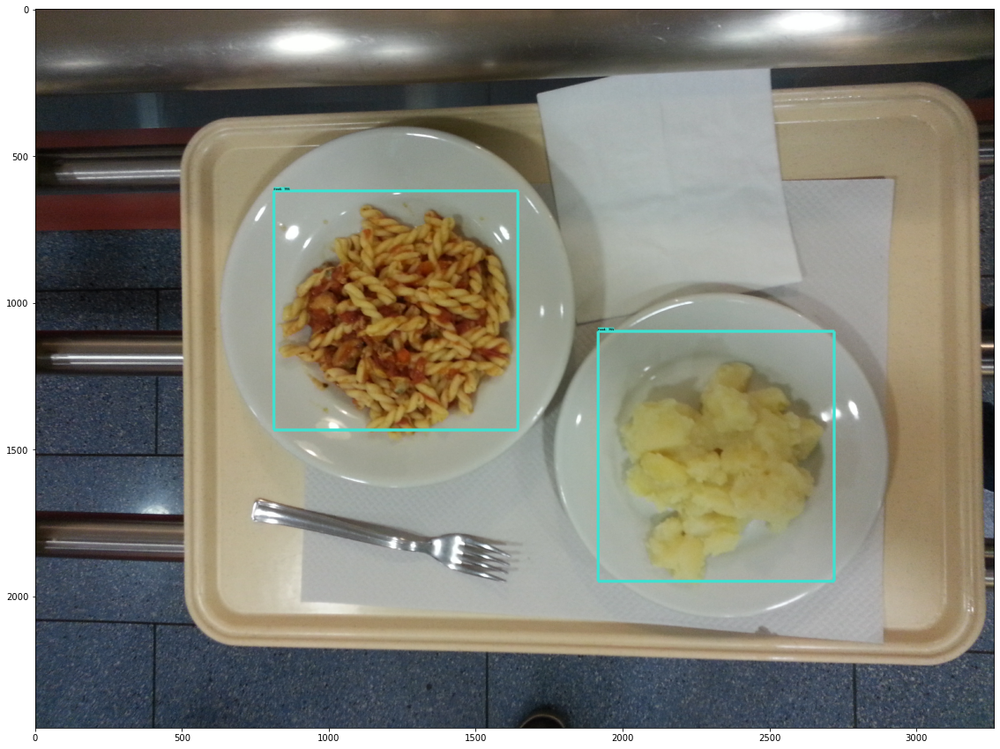

cannoli :  100.0 %
croque_madame :  88.707 %


Inference No.2 Food Image
Found 100 objects.
Inference time:  4.923269748687744
Font not found, using default font.


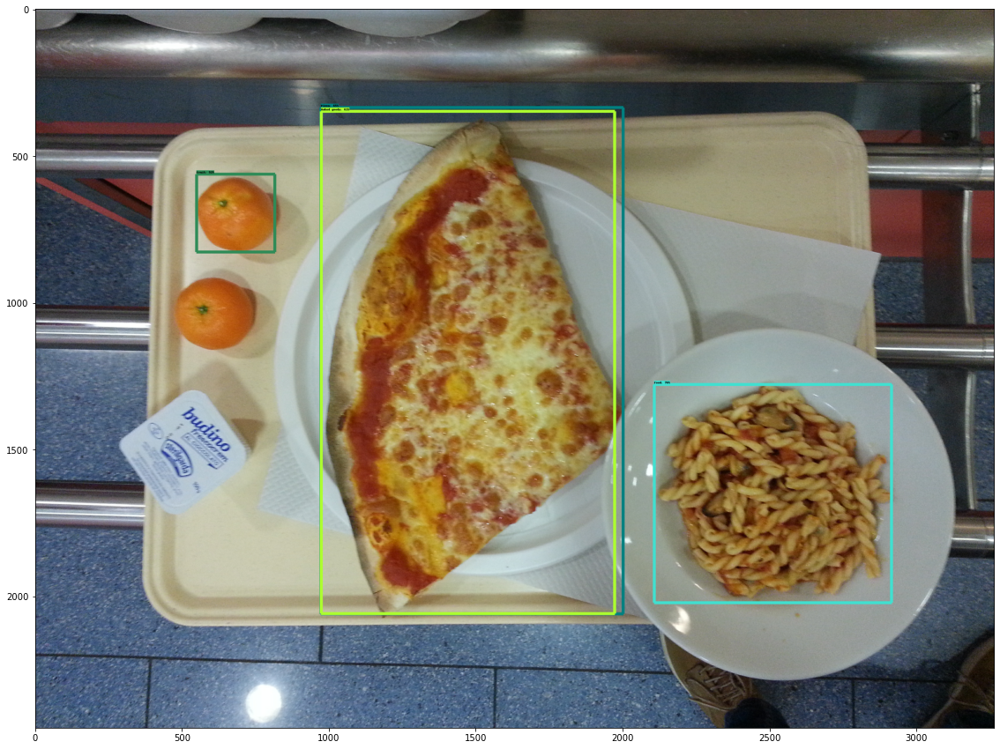

croque_madame :  100.0 %
falafel :  100.0 %
falafel :  99.968 %
croque_madame :  100.0 %


Inference No.3 Food Image
Found 100 objects.
Inference time:  4.9611077308654785
Font not found, using default font.


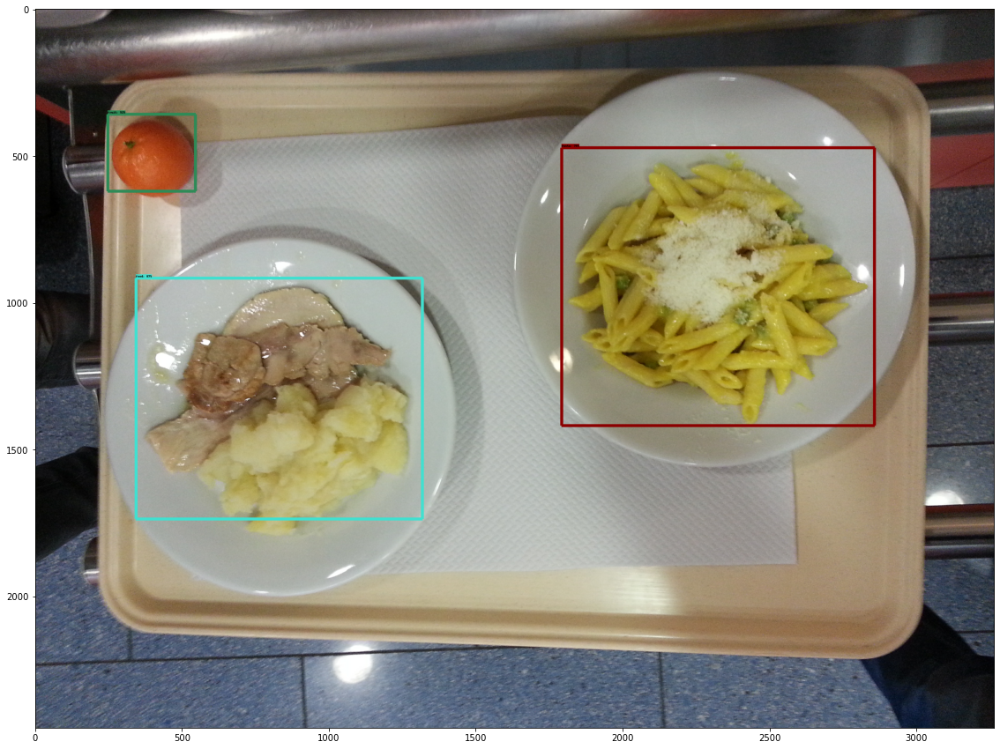

cannoli :  100.0 %
cannoli :  100.0 %
croque_madame :  100.0 %


Inference No.4 Food Image
Found 100 objects.
Inference time:  4.950669050216675
Font not found, using default font.


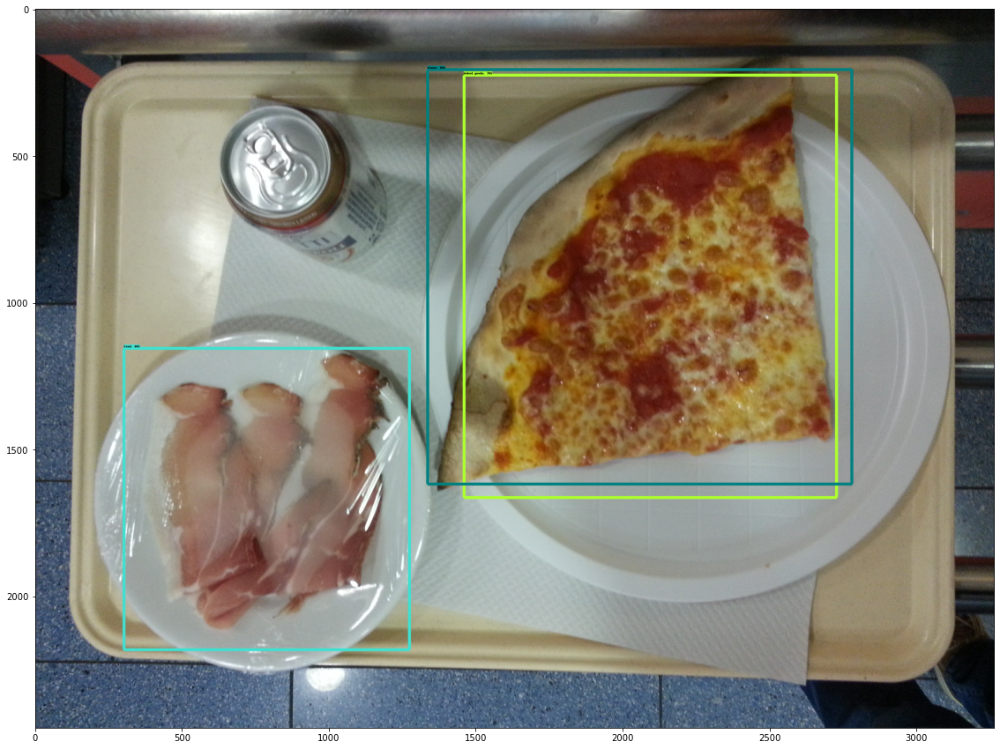

cannoli :  100.0 %
cannoli :  100.0 %
cannoli :  100.0 %


Inference No.5 Food Image
Found 100 objects.
Inference time:  4.947614908218384
Font not found, using default font.


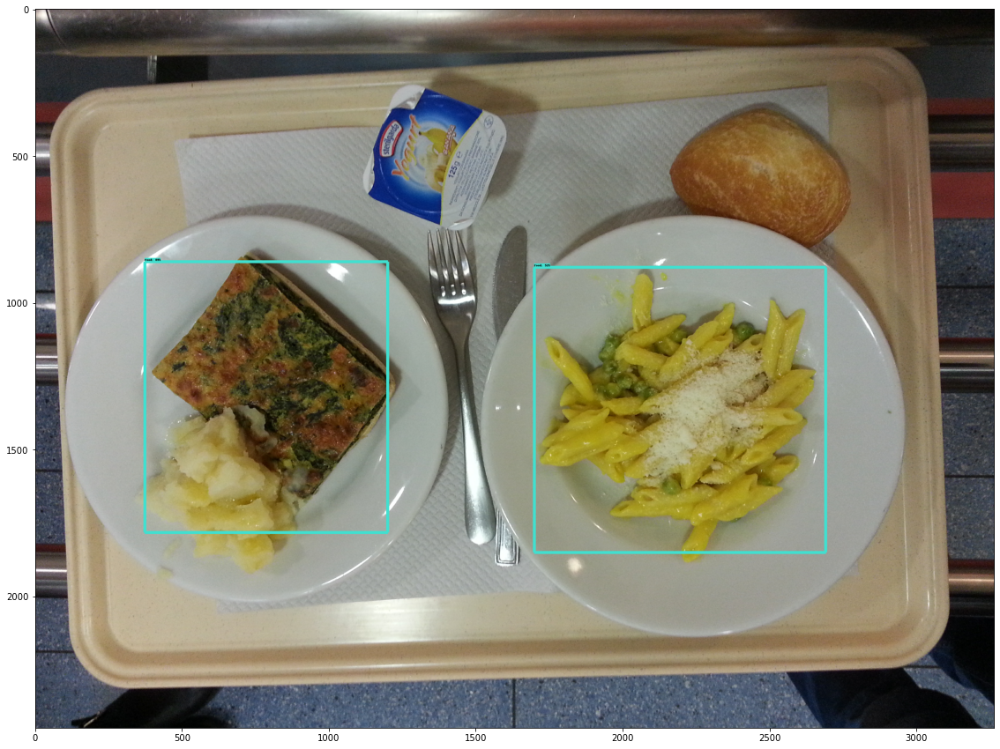

falafel :  100.0 %
cannoli :  100.0 %


Inference No.6 Food Image
Found 100 objects.
Inference time:  4.947237491607666
Font not found, using default font.


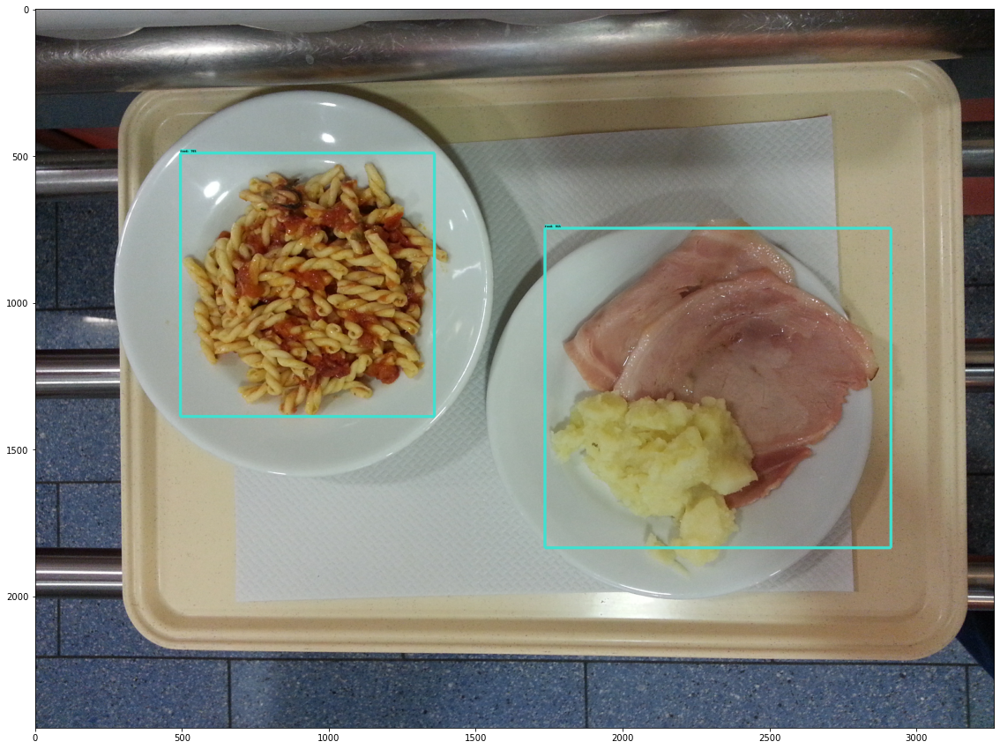

cannoli :  100.0 %
falafel :  100.0 %


Inference No.7 Food Image
Found 100 objects.
Inference time:  4.908383369445801
Font not found, using default font.


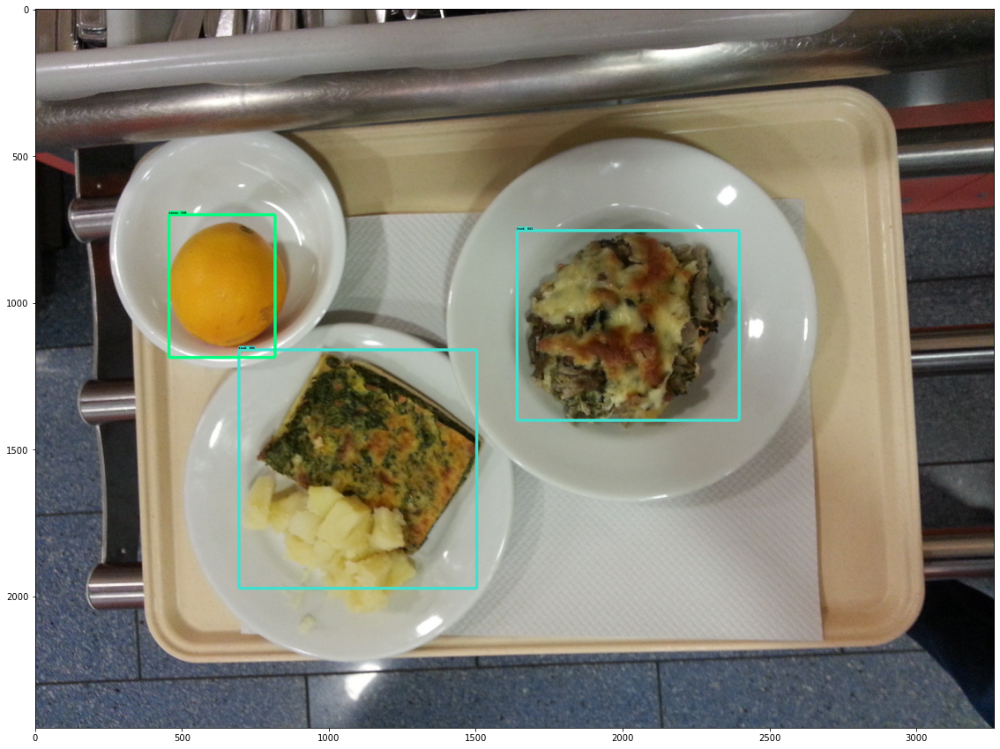

falafel :  63.134 %
falafel :  100.0 %
croque_madame :  100.0 %


Inference No.8 Food Image
Found 100 objects.
Inference time:  5.069814920425415
Font not found, using default font.


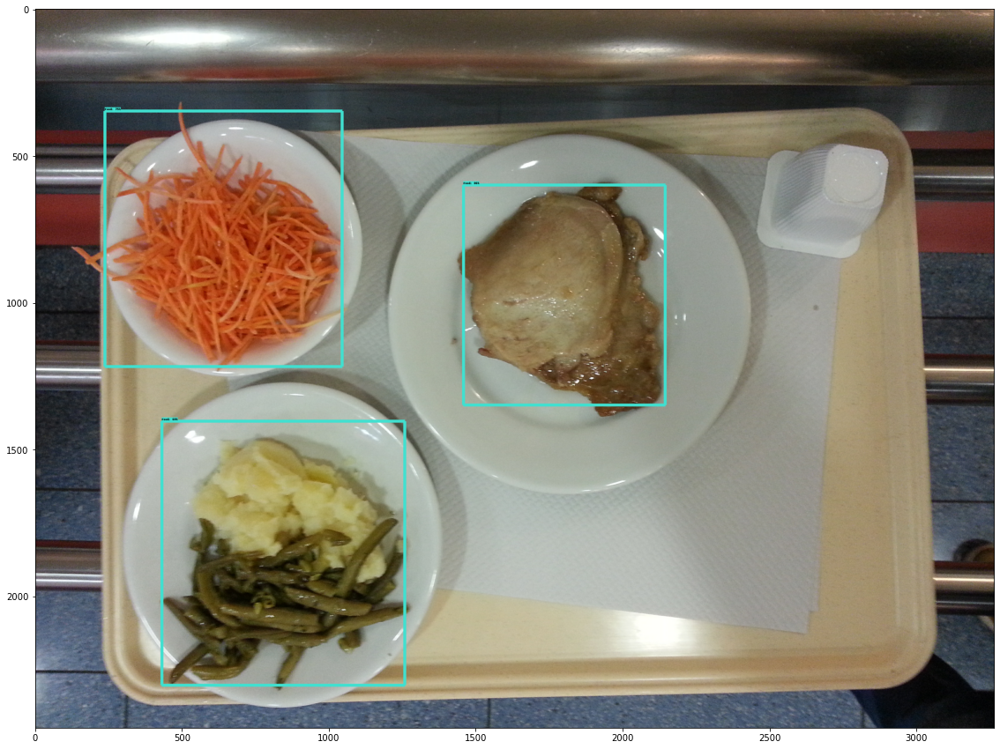

cannoli :  100.0 %
falafel :  99.999 %
falafel :  100.0 %


Inference No.9 Food Image
Found 100 objects.
Inference time:  4.890186071395874
Font not found, using default font.


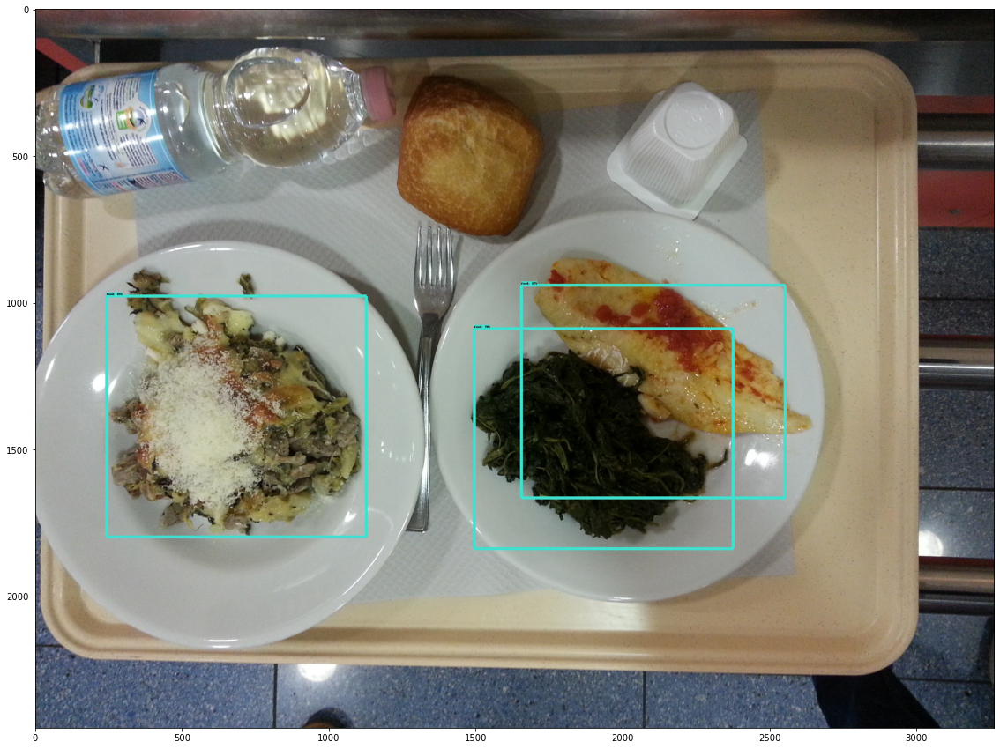

falafel :  100.0 %
falafel :  100.0 %
falafel :  100.0 %


Inference No.10 Food Image
Found 100 objects.
Inference time:  4.943763017654419
Font not found, using default font.


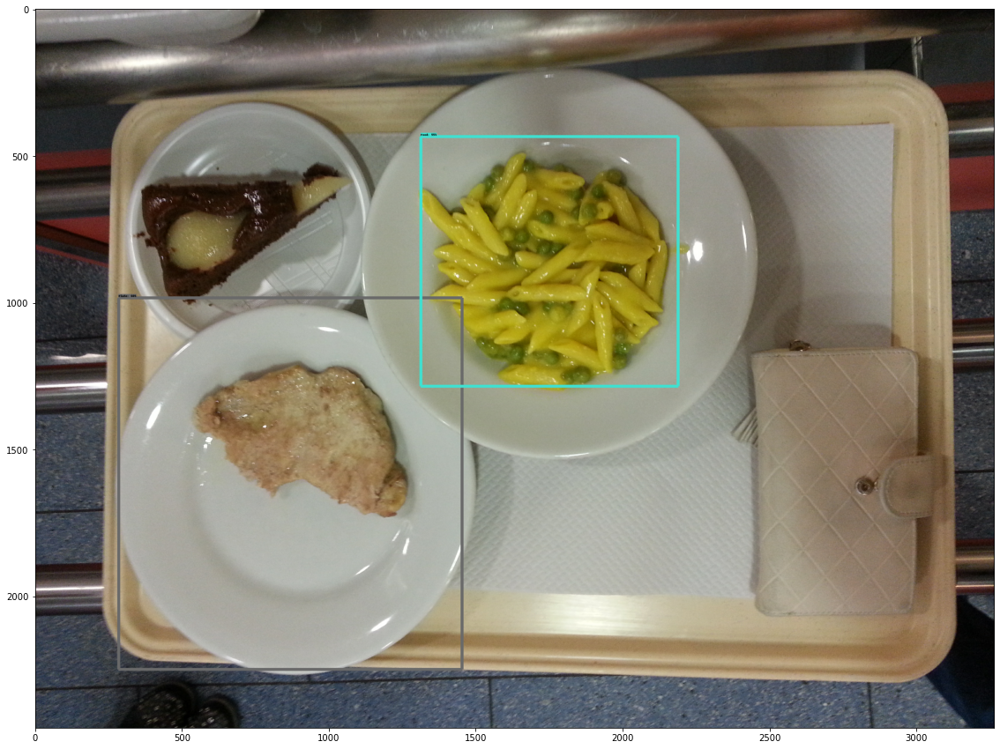

cannoli :  100.0 %
cannoli :  100.0 %


Inference No.11 Food Image
Found 100 objects.
Inference time:  4.937596559524536
Font not found, using default font.


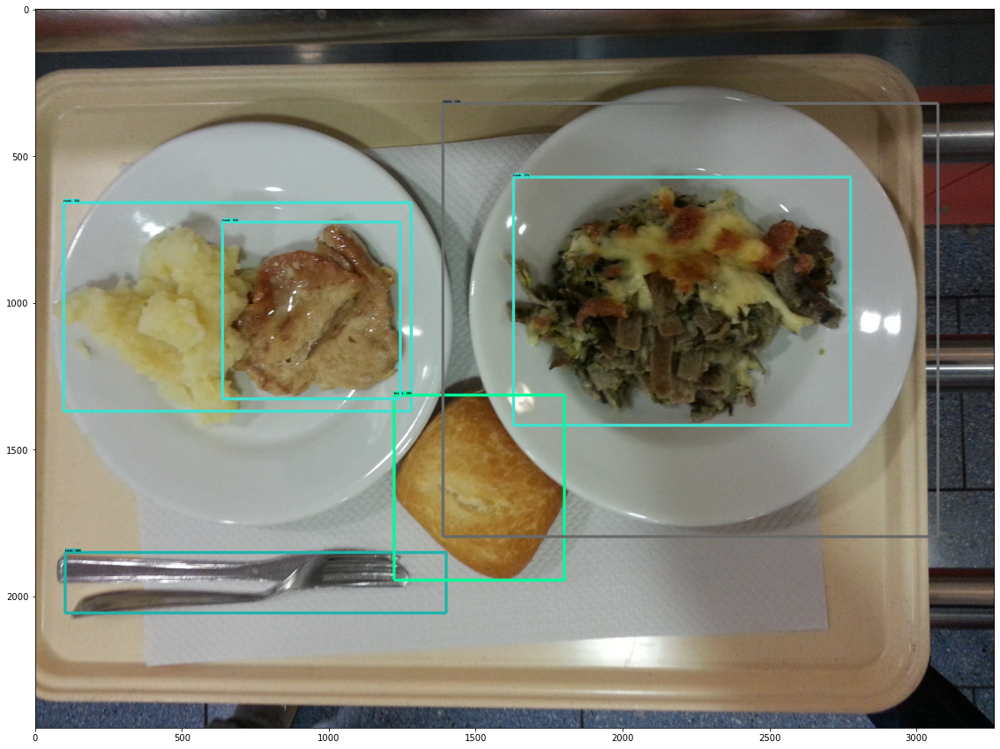

falafel :  100.0 %
falafel :  100.0 %
cannoli :  100.0 %
cannoli :  100.0 %
falafel :  100.0 %
cannoli :  99.997 %


Inference No.12 Food Image
Found 100 objects.
Inference time:  4.791315317153931
Font not found, using default font.


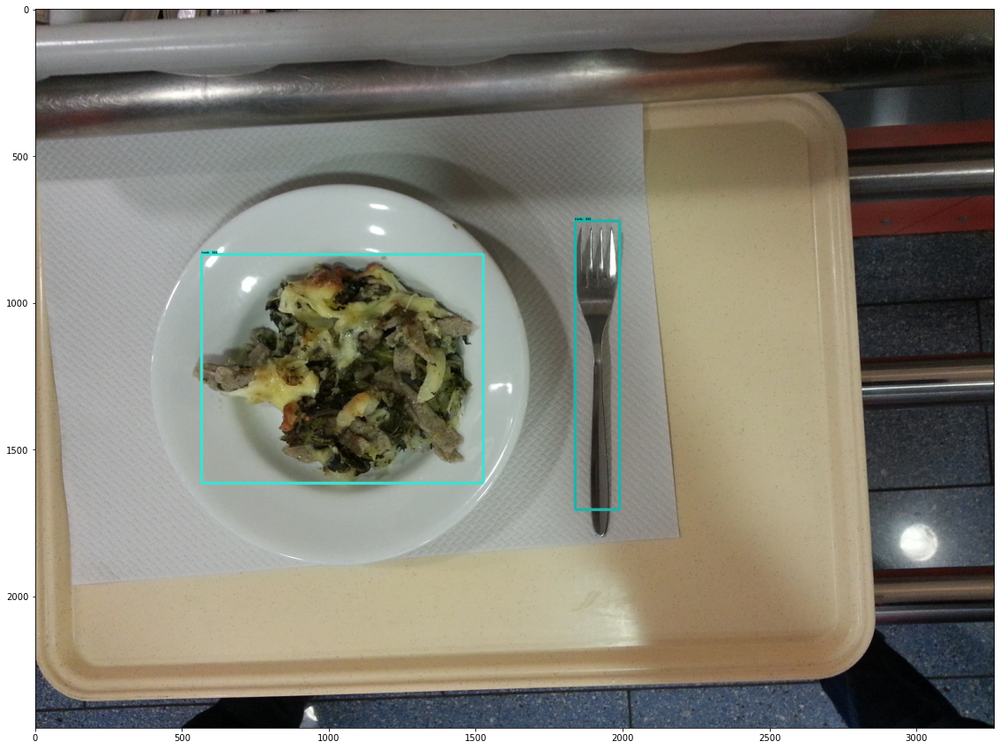

falafel :  100.0 %
cannoli :  99.807 %


Inference No.13 Food Image
Found 100 objects.
Inference time:  5.011225700378418
Font not found, using default font.


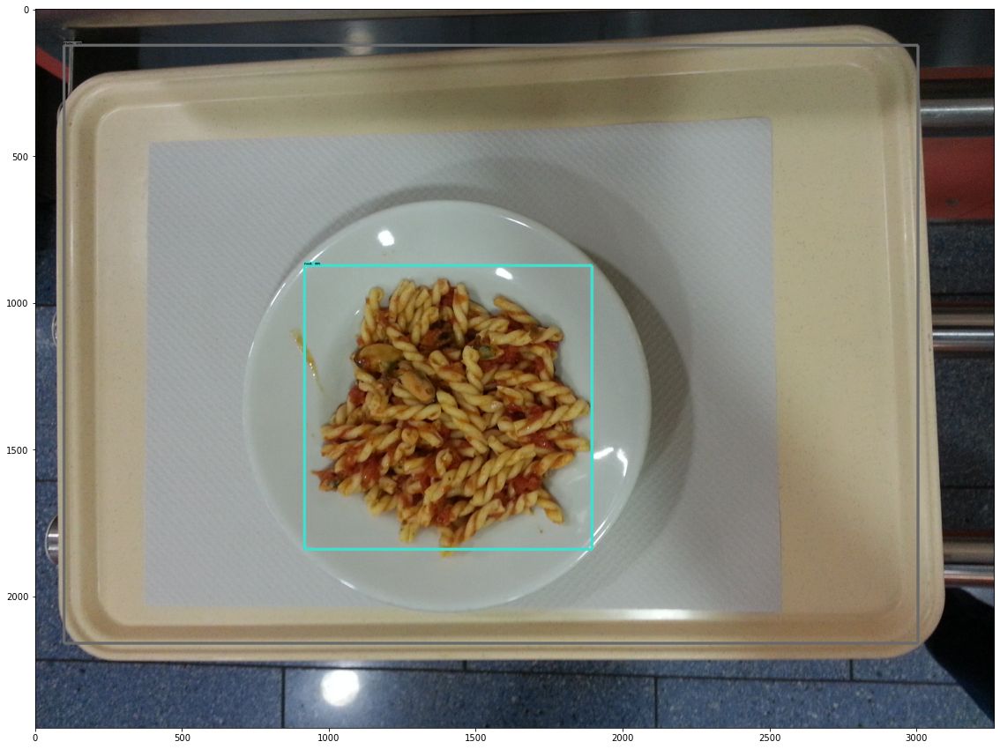

falafel :  100.0 %
falafel :  100.0 %


Inference No.14 Food Image
Found 100 objects.
Inference time:  4.931493282318115
Font not found, using default font.


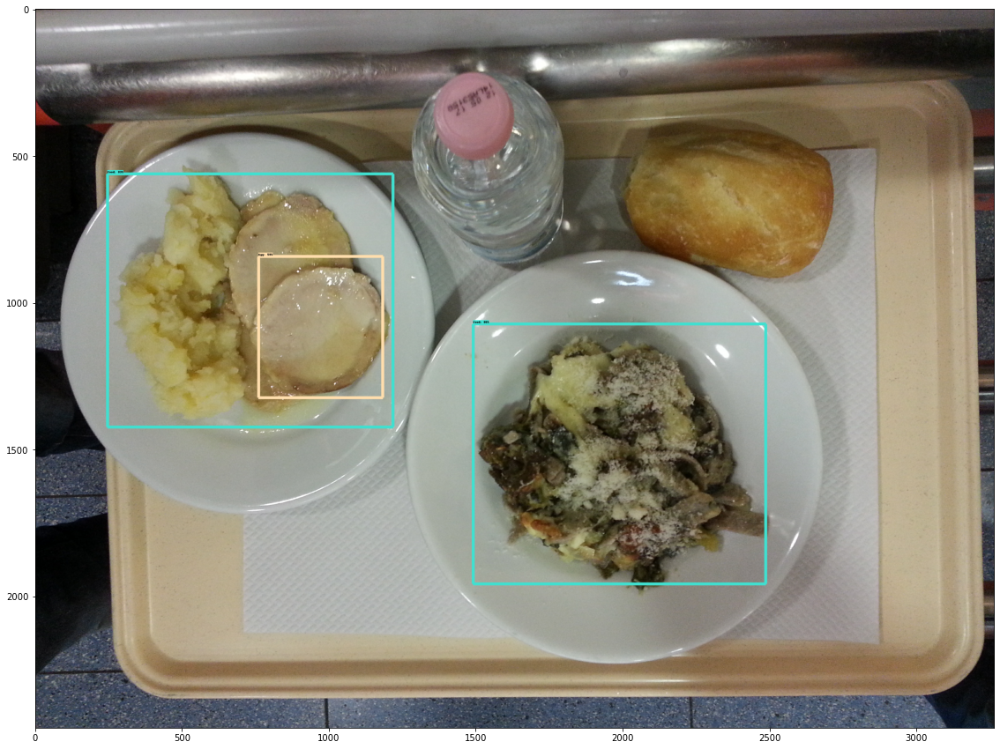

falafel :  100.0 %
cannoli :  100.0 %
cannoli :  100.0 %


Inference No.15 Food Image
Found 100 objects.
Inference time:  4.9367899894714355
Font not found, using default font.


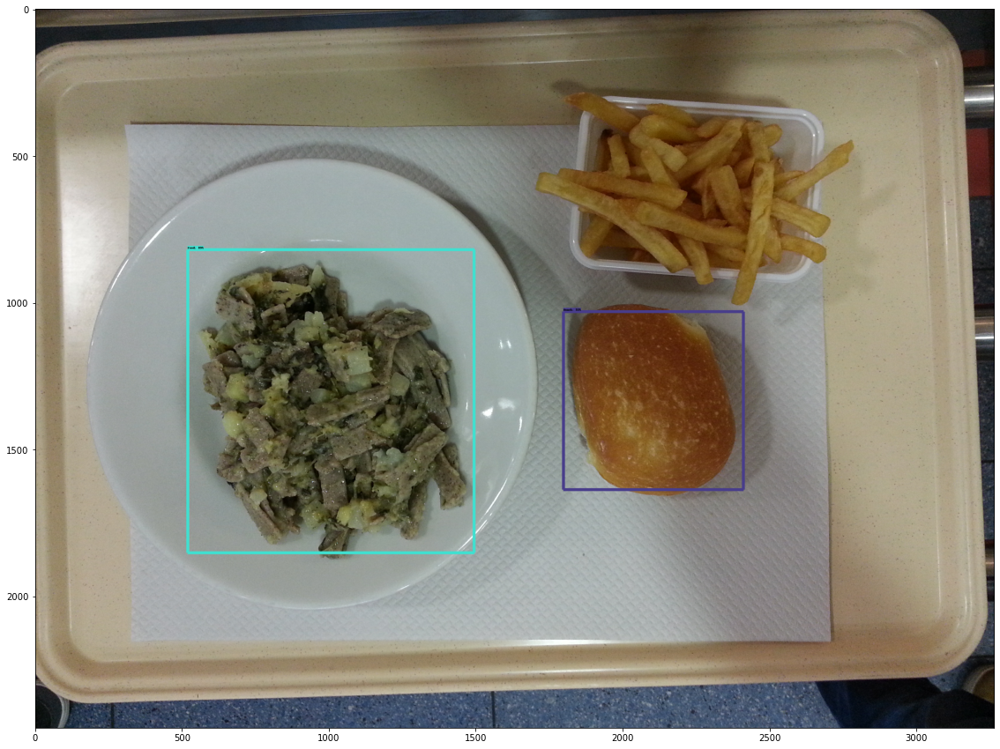

falafel :  100.0 %
croque_madame :  71.682 %


Inference No.16 Food Image
Found 100 objects.
Inference time:  4.912207841873169
Font not found, using default font.


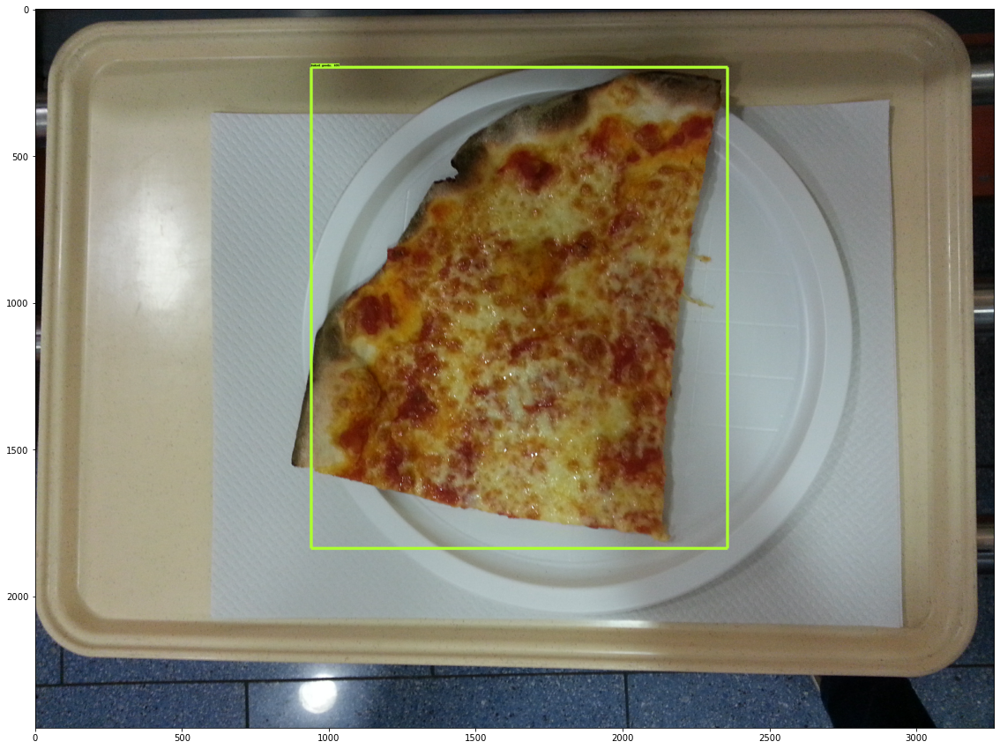

falafel :  100.0 %


Inference No.17 Food Image
Found 100 objects.
Inference time:  4.937499046325684
Font not found, using default font.


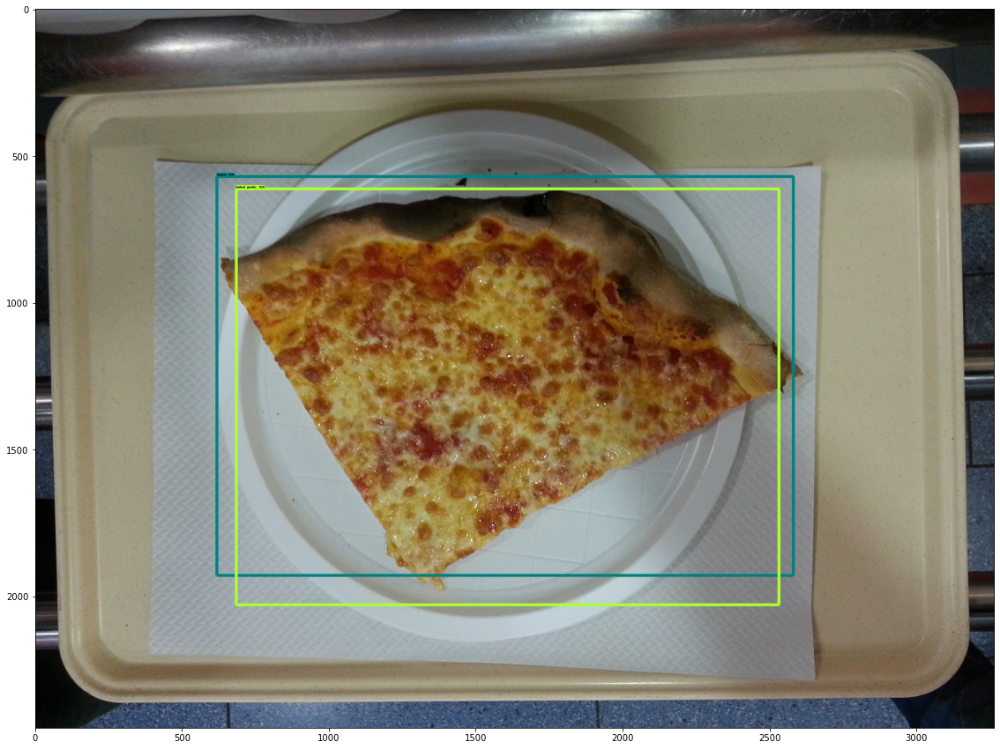

falafel :  100.0 %
falafel :  100.0 %


Inference No.18 Food Image
Found 100 objects.
Inference time:  4.984330892562866
Font not found, using default font.


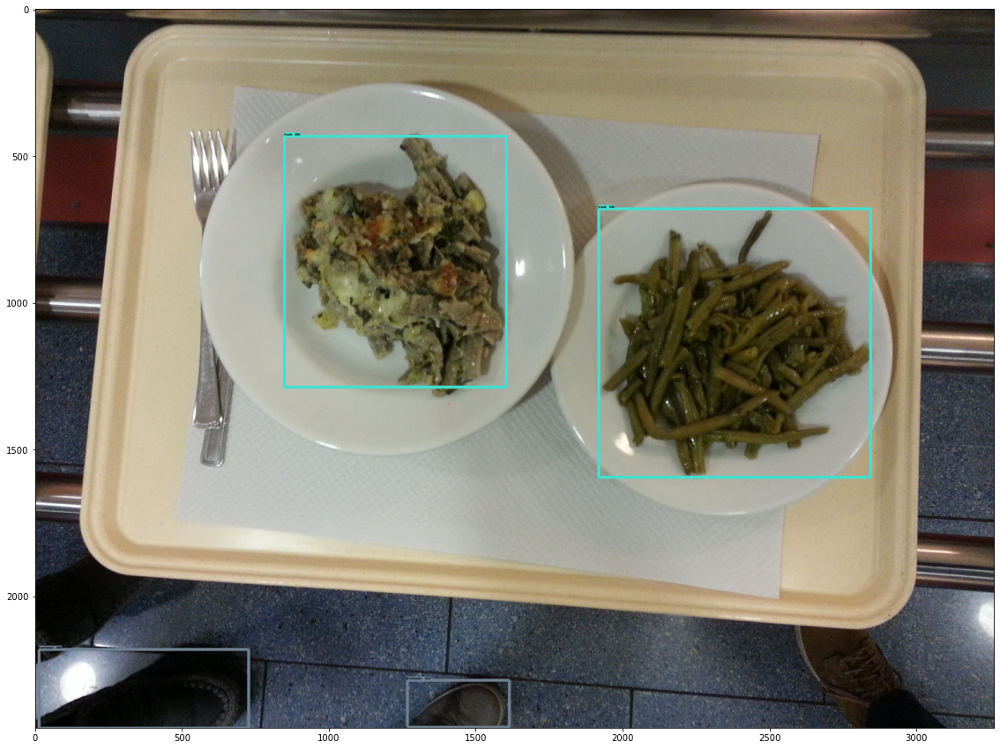

KeyboardInterrupt: 

In [39]:
import tensorflow as tf
import tensorflow_hub as hub
# For downloading the image.
import matplotlib.pyplot as plt
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

# For drawing onto the image.
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps
import cv2
import pandas as pd

# For measuring the inference time.
import time

# Print Tensorflow version
print("Tensorflow Version: {}".format(tf.__version__))
# Check available GPU devices.
print("The following GPU devices are available: %s" % tf.test.gpu_device_name())

## Example use

### Helper functions for downloading images and for visualization.

#Visualization code adapted from [TF object detection API](https://github.com/tensorflow/models/blob/master/research/object_detection/utils/visualization_utils.py) for the simplest required functionality.

def display_image(image):
  fig = plt.figure(figsize=(20, 15))
  plt.grid(False)
  plt.imshow(image)


def download_and_resize_image(url, new_width=256, new_height=256,
                              display=False):
  _, filename = tempfile.mkstemp(suffix=".jpg")
  response = urlopen(url)
  image_data = response.read()
  image_data = BytesIO(image_data)
  pil_image = Image.open(image_data)
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
  pil_image_rgb = pil_image.convert("RGB")
  pil_image_rgb.save(filename, format="JPEG", quality=90)
  print("Image downloaded to %s." % filename)
  if display:
    display_image(pil_image)
  return filename

def draw_bounding_box_on_image(image,
                               ymin,
                               xmin,
                               ymax,
                               xmax,
                               color,
                               font,
                               thickness=10,
                               display_str_list=()):
  """Adds a bounding box to an image."""
  draw = ImageDraw.Draw(image)
  im_width, im_height = image.size
  (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                ymin * im_height, ymax * im_height)
  draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
             (left, top)],
            width=thickness,
            fill=color)

  # If the total height of the display strings added to the top of the bounding
  # box exceeds the top of the image, stack the strings below the bounding box
  # instead of above.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
  # Each display_str has a top and bottom margin of 0.05x.
  total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

  if top > total_display_str_height:
    text_bottom = top
  else:
    text_bottom = top + total_display_str_height
  # Reverse list and print from bottom to top.
  for display_str in display_str_list[::-1]:
    text_width, text_height = font.getsize(display_str)
    margin = np.ceil(0.05 * text_height)
    draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                    (left + text_width, text_bottom)],
                   fill=color)
    draw.text((left + margin, text_bottom - text_height - margin),
              display_str,
              fill="black",
              font=font)
    text_bottom -= text_height - 2 * margin

def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.5):
  """Overlay labeled boxes on an image with formatted scores and label names."""
  colors = list(ImageColor.colormap.values())

  try:
    font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",
                              25)
  except IOError:
    print("Font not found, using default font.")
    font = ImageFont.load_default()

  for i in range(min(boxes.shape[0], max_boxes)):
    if scores[i] >= min_score:
      ymin, xmin, ymax, xmax = tuple(boxes[i])
      display_str = "{}: {}%".format(class_names[i].decode("ascii"),
                                     int(100 * scores[i]))
      color = colors[hash(class_names[i]) % len(colors)]
      image_pil = Image.fromarray(np.uint8(image)).convert("RGB")
      draw_bounding_box_on_image(
          image_pil,
          ymin,
          xmin,
          ymax,
          xmax,
          color,
          font,
          display_str_list=[display_str])
      np.copyto(image, np.array(image_pil))
  return image

## Apply module

#Load a public image from Open Images v4, save locally, and display.

#Pick an object detection module and apply on the downloaded image. Modules:
#* **FasterRCNN+InceptionResNet V2**: high accuracy,
#* **ssd+mobilenet V2**: small and fast.


def load_img(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_jpeg(img, channels=3)
    return img

def run_detector(detector, path):
  img = load_img(path)

  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
  start_time = time.time()
  result = detector(converted_img)
  end_time = time.time()

  result = {key:value.numpy() for key,value in result.items()}

  print("Found %d objects." % len(result["detection_scores"]))
  print("Inference time: ", end_time-start_time)

  image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"])

  display_image(image_with_boxes)
  return result

def crop_roi_food(path,res,index,conf=.5):
    if res["detection_scores"][index] >= conf:
        ymin, xmin, ymax, xmax = tuple(res["detection_boxes"][index])
        img = load_img(path)
        im_width = img.shape[1]
        im_height = img.shape[0]
        (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                    ymin * im_height, ymax * im_height)
        obj_image = img[int(top):int(bottom),int(left):int(right)]
        obj_image = np.array(obj_image)
        obj_image = cv2.resize(obj_image, (250, 250), interpolation=cv2.INTER_AREA)
        
        #plt.imshow(obj_image)
        return  obj_image

if __name__=="__main__":
    
    import glob
    import pandas as pd
    test_list = glob.glob("./test_img/*.jpg")
    """
    try:
        module_handle = "D:/pythonwork/Eating_health_management/faster_rcnn_openimages_v4_inception_resnet_v2_1"
        print("Loading {} Model...".format(module_handle.split("/")[-1]))
        detector = hub.load(module_handle).signatures['default']
        print("Load Model Successfully")


    except:
        print("Load Model Failed")

    """
    class_df = pd.read_csv("dict.csv")
    while True:
        
        if len(test_list) == 0:
            
            print("Waiting...")
       
        else:
            for i,path in enumerate(test_list[:50]):
                obj_list = []
                print("Inference No.{} Food Image".format(i+1))
                res = run_detector(detector, path)
                plt.show()
                obj_len = res["detection_scores"][res["detection_scores"]>=0.5].shape[0]
                for i in range(obj_len):
                    obj_list.append([crop_roi_food(path,res,i)])
                obj_arr = np.concatenate(obj_list)
                classfi_res = model_ResNet.predict(obj_arr)
                for i in range(classfi_res.shape[0]):
                    
                    print(class_df[class_df["value"]==np.argmax(classfi_res[i])]["Class name"].values[0],": ",round(classfi_res[i,np.argmax(classfi_res[i])]*100,3),"%")
                print("\n")
            test_list = []



In [20]:
res["detection_scores"][res["detection_scores"]>=0.5].shape[0]

2

In [21]:
import cv2

Found 100 objects.
Inference time:  0.8908231258392334
Font not found, using default font.


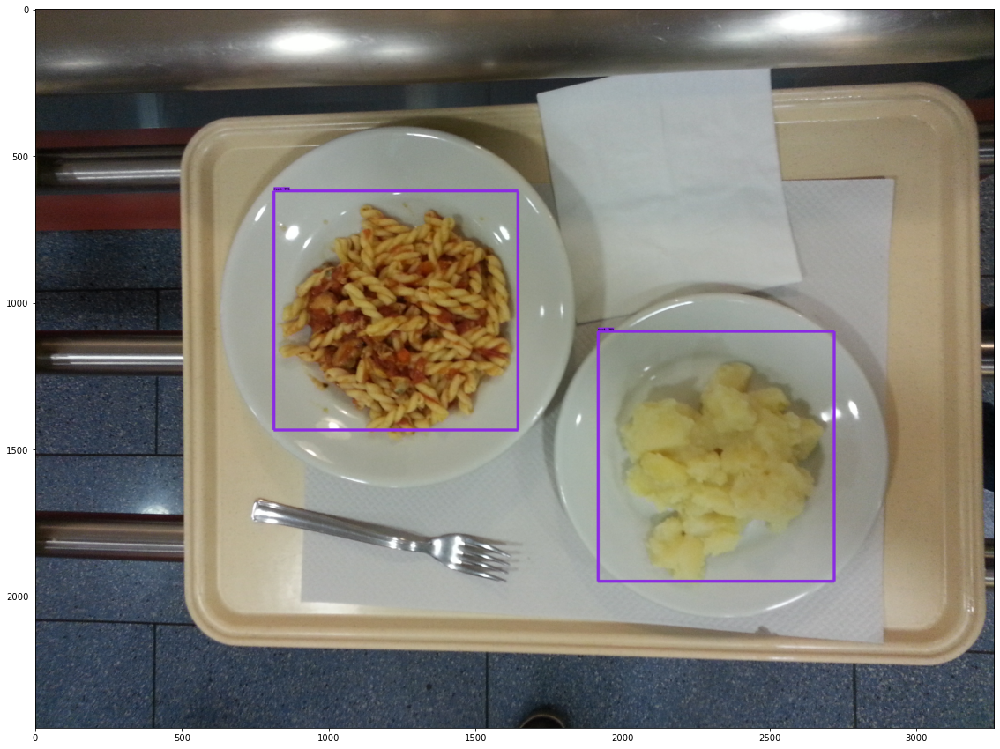

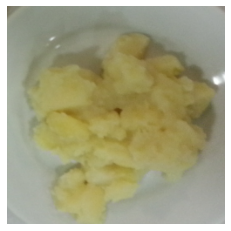

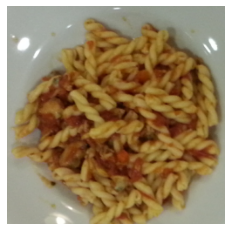

No Object
No Object
No Object
No Object
No Object
No Object
No Object
No Object


In [26]:
def crop_roi_food(path,res,index,conf=.5):
    if res["detection_scores"][index] >= conf:
        plt.axis('off')
        ymin, xmin, ymax, xmax = tuple(res["detection_boxes"][index])
        img = load_img(path)
        im_width = img.shape[1]
        im_height = img.shape[0]
        (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                    ymin * im_height, ymax * im_height)
        obj_image = img[int(top):int(bottom),int(left):int(right)]
        obj_image = np.array(obj_image)
        obj_image = cv2.resize(obj_image, (250, 250), interpolation=cv2.INTER_AREA)
        
        plt.imshow(obj_image)
        
        return  obj_image
        
    else:
        print("No Object")

if __name__=="__main__":
    
    path = "./test_img/20151127_114556.jpg"
    res = run_detector(detector, path)
    plt.show()
    for i in range(0,10):
        crop_img = crop_roi_food(path,res,i)
        plt.show()

In [27]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import tensorflow as tf

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session
"""
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        tf.config.experimental.set_virtual_device_configuration(gpus[0], 
        [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=5000)])
    except RuntimeError as e:
        print(e)
"""

data_dir = 'images/'

from tensorflow.keras.preprocessing.image import ImageDataGenerator

## ***Data Collection***

#datagen = ImageDataGenerator(rescale = 1./255, validation_split = 0.2)
datagen = ImageDataGenerator(
      featurewise_center=False, samplewise_center=False,
    featurewise_std_normalization=False, samplewise_std_normalization=False,
    zca_whitening=False, zca_epsilon=1e-06, rotation_range=0, width_shift_range=0.0,
    height_shift_range=0.0, brightness_range=[0.5, 1], shear_range=10, zoom_range=0.5,
    channel_shift_range=100, fill_mode='nearest', cval=0.0,
    horizontal_flip=True, vertical_flip=True,rescale=1. / 255,
    preprocessing_function=None, data_format=None, validation_split=0.2, dtype=None
)

BATCH_SIZE = 64
IMG_W=250
IMG_H=250

train_data = datagen.flow_from_directory(data_dir, target_size = (IMG_W,IMG_H), batch_size = BATCH_SIZE, class_mode = 'categorical',
                                        subset = 'training')

val_data = datagen.flow_from_directory(data_dir, target_size = (IMG_W,IMG_H), batch_size = BATCH_SIZE, class_mode = 'categorical',
                                        subset = 'validation')

import tensorflow_hub as hub
ResNet_V2_50 = 'https://tfhub.dev/google/imagenet/resnet_v2_50/classification/5'
Efficientnet_b0 = "https://tfhub.dev/google/efficientnet/b0/classification/1"
Efficientnet_b7 = "D:/pythonwork/Eating_health_management/efficientnet_b7_classification_1"

Found 80800 images belonging to 101 classes.
Found 20200 images belonging to 101 classes.


In [29]:
type(train_data.class_indices)

dict

In [31]:
import csv
with open('dict.csv', 'w') as csv_file:  
    writer = csv.writer(csv_file)
    writer.writerow(["Class name", "value"])
    for key, value in train_data.class_indices.items():
       writer.writerow([key, value])